In [1]:
from __future__ import print_function

In [16]:
import numpy as np 


import matplotlib.pyplot as plt 

import IPython.display 
import librosa 

import librosa.display

In [5]:
audio_path = './soundfiles/viva_la_vida_coldplay.mp3'
# sr is sample rate, default at 22khz, can change to 44.1 k 
y,sr = librosa.load(audio_path)

/home/toto/anaconda3/envs/sounds/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


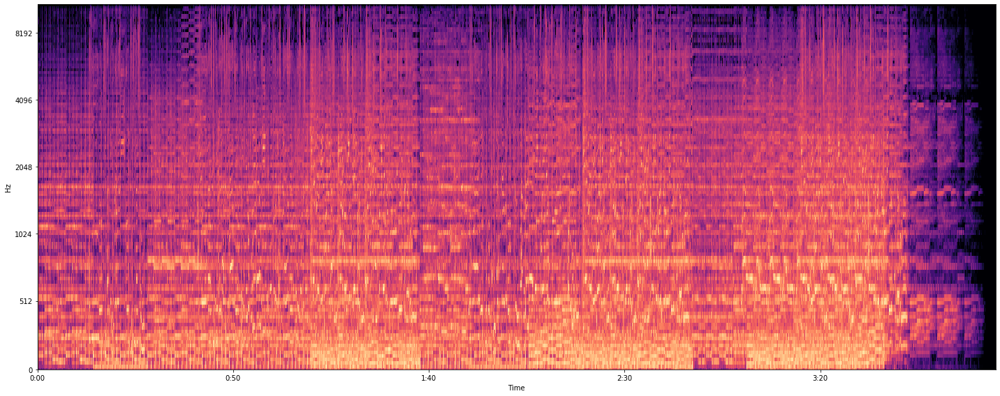

In [11]:
S = librosa.feature.melspectrogram(y,sr=sr,n_mels = 128)


log_S = librosa.power_to_db(S,ref= np.max)

plt.figure( figsize= (20,8))

librosa.display.specshow(log_S,sr=sr, x_axis = 'time',y_axis='mel')

plt.tight_layout()

In [15]:
IPython.display.Audio(data = y,rate=sr)

In [18]:
y_h , y_p = librosa .effects.hpss(y)

In [19]:
IPython.display.Audio(data = y_h,rate=sr)

In [20]:
IPython.display.Audio(data = y_p,rate=sr)

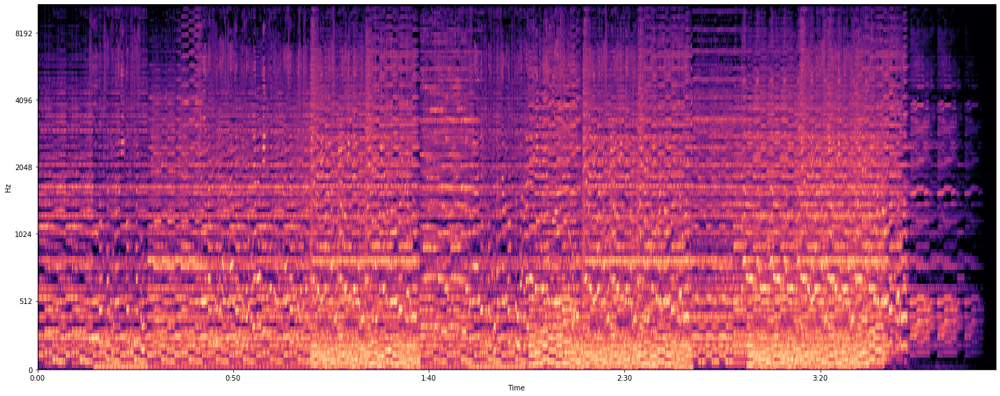

In [21]:
S = librosa.feature.melspectrogram(y_h,sr=sr,n_mels = 128)


log_S = librosa.power_to_db(S,ref= np.max)

plt.figure( figsize= (20,8))

librosa.display.specshow(log_S,sr=sr, x_axis = 'time',y_axis='mel')

plt.tight_layout()

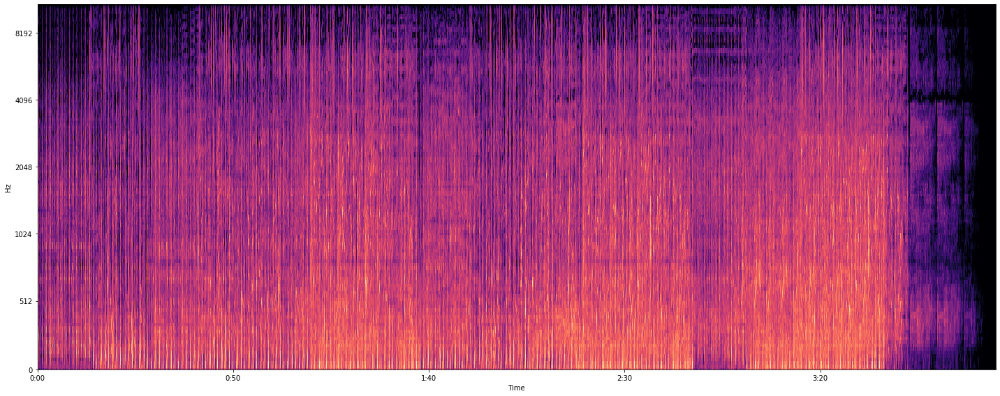

In [22]:
S = librosa.feature.melspectrogram(y_p,sr=sr,n_mels = 128)


log_S = librosa.power_to_db(S,ref= np.max)

plt.figure( figsize= (20,8))

librosa.display.specshow(log_S,sr=sr, x_axis = 'time',y_axis='mel')

plt.tight_layout()

In [23]:
# more advanced. decompose with nmf and then resynth  an idividual component

D = librosa.stft(y)

S,phase = librosa.magphase(D)

#decompose by nmf 
components, activations = librosa.decompose.decompose(S,n_components=8,sort = True)

Text(0.5, 1.0, 'Activations')

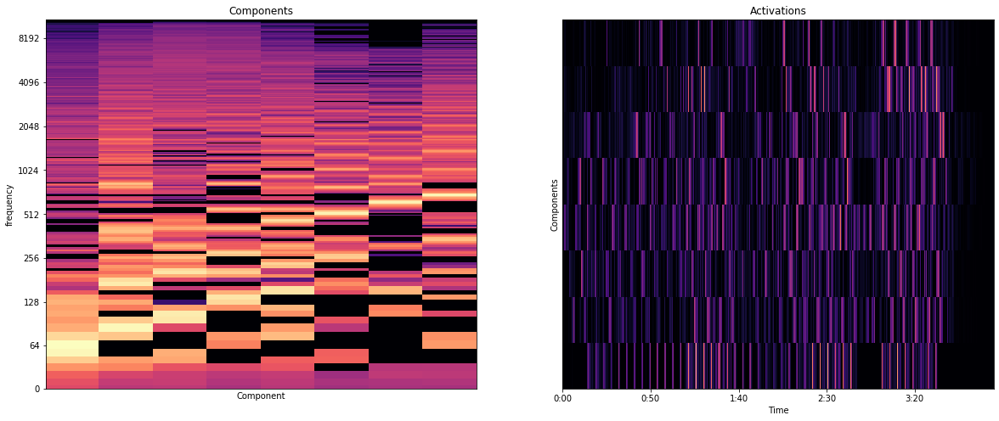

In [26]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(components),ref= np.max),y_axis ='log')
plt.xlabel('Component')
plt.ylabel('frequency')
plt.title('Components')


plt.subplot(1,2,2)
librosa.display.specshow(activations,x_axis ='time')
plt.xlabel('Time')
plt.ylabel('Components')
plt.title('Activations')


In [33]:

print(activations.shape,components.shape)

(8, 10541) (1025, 8)


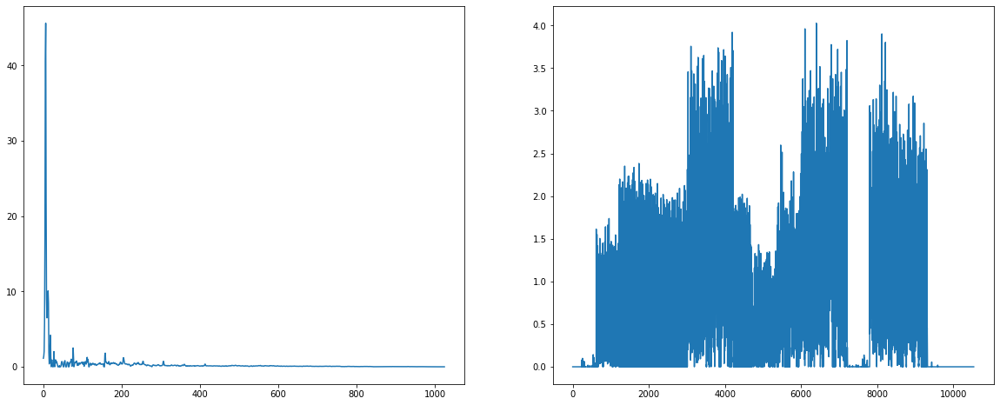

In [35]:

#  i dont understand nmf  decomp but this is the url 
# https://musicinformationretrieval.com/nmf.html

#activation / component  0
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
plt.plot(components[:,0])

plt.subplot(1,2,2)
plt.plot(activations.T[:,0])

Text(0, 0.5, 'what am i ')

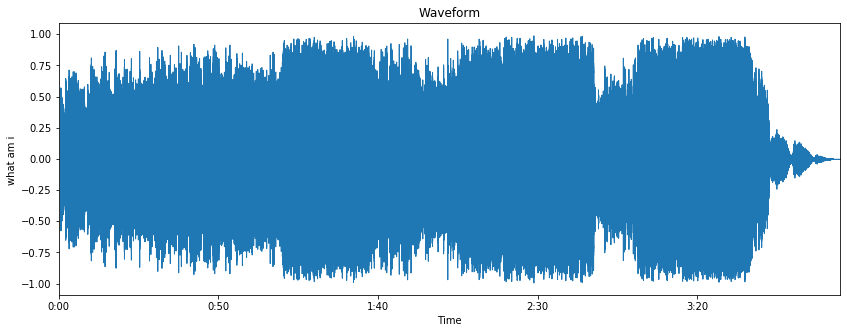

In [38]:


plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr=sr)
plt.title('Waveform')
plt.xlabel('Time')
plt.ylabel('what am i ')


In [ ]:
# create a pure sine wave
sr = 22050 # sample rate
T = 2.0    # seconds
t = numpy.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*numpy.sin(2*numpy.pi*440*t)                # pure sine wave at 440 Hz
# librosa.output.write_wav('audio/tone_440.wav', x, sr)